In [1]:
!mkdir data_faces && wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 

mkdir: cannot create directory ‘data_faces’: File exists


In [1]:
import zipfile

with zipfile.ZipFile("celeba.zip","r") as zip_ref:
  zip_ref.extractall("data_faces/")

In [2]:
import os
root = 'data_faces/img_align_celeba'
img_list = os.listdir(root)
print(len(img_list))

202599


In [3]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [4]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from torchvision.utils import make_grid
from torchvision.utils import save_image
from IPython.display import HTML

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [5]:
# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

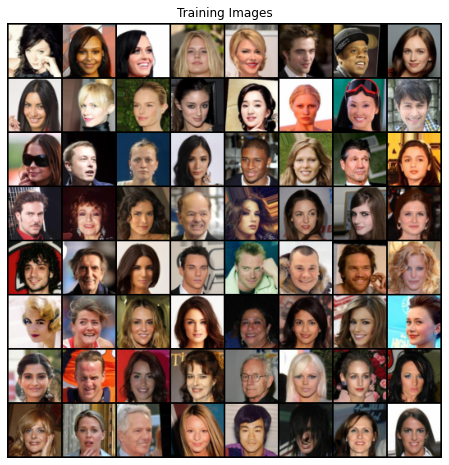

In [6]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset

crop_size = 108
re_size = 64
offset_height = (218 - crop_size) // 2
offset_width = (178 - crop_size) // 2
crop = lambda x: x[:, offset_height:offset_height + crop_size, offset_width:offset_width + crop_size]

transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

dataset = dset.ImageFolder('./data_faces', transform=transform)
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [7]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [11]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [12]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Starting Training Loop...
[0/10][0/1586]	Loss_D: 1.8467	Loss_G: 2.0292	D(x): 0.2857	D(G(z)): 0.2659 / 0.1757


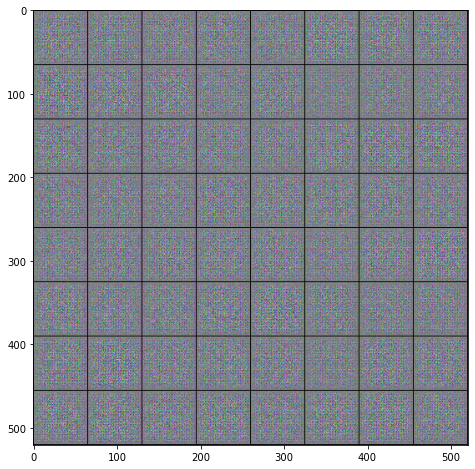

Saving generated-images-0000000.png
[0/10][50/1586]	Loss_D: 0.0693	Loss_G: 34.7227	D(x): 0.9616	D(G(z)): 0.0000 / 0.0000
[0/10][100/1586]	Loss_D: 0.4476	Loss_G: 27.8799	D(x): 0.8022	D(G(z)): 0.0000 / 0.0000
[0/10][150/1586]	Loss_D: 0.3045	Loss_G: 8.3519	D(x): 0.9047	D(G(z)): 0.1458 / 0.0007
[0/10][200/1586]	Loss_D: 0.9135	Loss_G: 8.1657	D(x): 0.9791	D(G(z)): 0.4748 / 0.0011
[0/10][250/1586]	Loss_D: 0.4208	Loss_G: 3.8883	D(x): 0.7938	D(G(z)): 0.1081 / 0.0300
[0/10][300/1586]	Loss_D: 1.1645	Loss_G: 6.3173	D(x): 0.4742	D(G(z)): 0.0138 / 0.0133
[0/10][350/1586]	Loss_D: 0.3804	Loss_G: 2.7553	D(x): 0.7857	D(G(z)): 0.0760 / 0.0759
[0/10][400/1586]	Loss_D: 0.7671	Loss_G: 5.7639	D(x): 0.9490	D(G(z)): 0.4652 / 0.0066
[0/10][450/1586]	Loss_D: 0.9228	Loss_G: 7.5677	D(x): 0.9103	D(G(z)): 0.4963 / 0.0012
[0/10][500/1586]	Loss_D: 0.5966	Loss_G: 4.6359	D(x): 0.8418	D(G(z)): 0.2846 / 0.0209


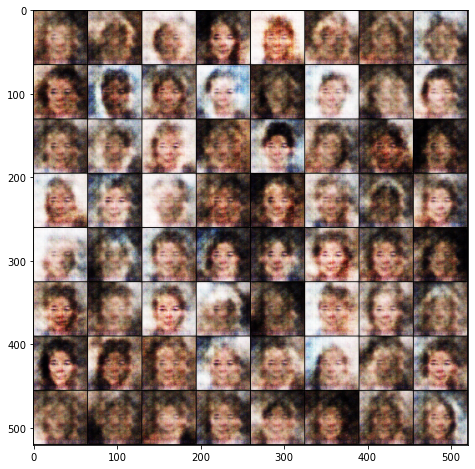

Saving generated-images-0000000.png
[0/10][550/1586]	Loss_D: 0.4371	Loss_G: 3.4694	D(x): 0.8464	D(G(z)): 0.1948 / 0.0520
[0/10][600/1586]	Loss_D: 1.6819	Loss_G: 9.6915	D(x): 0.9634	D(G(z)): 0.6965 / 0.0003
[0/10][650/1586]	Loss_D: 0.4028	Loss_G: 3.3912	D(x): 0.9129	D(G(z)): 0.1974 / 0.0643
[0/10][700/1586]	Loss_D: 0.5934	Loss_G: 3.1853	D(x): 0.6828	D(G(z)): 0.0286 / 0.0699
[0/10][750/1586]	Loss_D: 0.5711	Loss_G: 7.9267	D(x): 0.9407	D(G(z)): 0.3508 / 0.0010
[0/10][800/1586]	Loss_D: 0.5417	Loss_G: 3.9792	D(x): 0.8197	D(G(z)): 0.2243 / 0.0312
[0/10][850/1586]	Loss_D: 0.5812	Loss_G: 6.0336	D(x): 0.8697	D(G(z)): 0.3003 / 0.0050
[0/10][900/1586]	Loss_D: 0.8920	Loss_G: 4.4168	D(x): 0.7410	D(G(z)): 0.3658 / 0.0245
[0/10][950/1586]	Loss_D: 1.4562	Loss_G: 1.3617	D(x): 0.3983	D(G(z)): 0.0323 / 0.4064
[0/10][1000/1586]	Loss_D: 0.5888	Loss_G: 4.6573	D(x): 0.8198	D(G(z)): 0.2294 / 0.0206


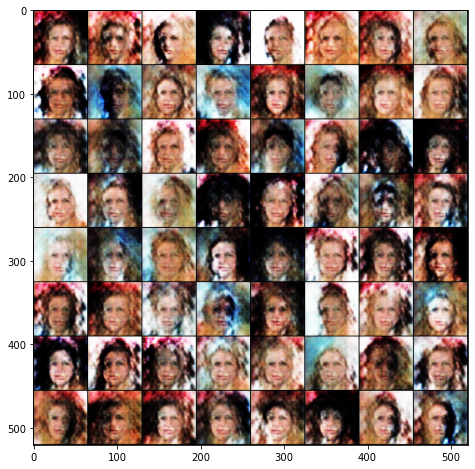

Saving generated-images-0000000.png
[0/10][1050/1586]	Loss_D: 1.0768	Loss_G: 4.8698	D(x): 0.9496	D(G(z)): 0.5718 / 0.0150
[0/10][1100/1586]	Loss_D: 0.5589	Loss_G: 3.8368	D(x): 0.8687	D(G(z)): 0.2805 / 0.0443
[0/10][1150/1586]	Loss_D: 0.6364	Loss_G: 4.0827	D(x): 0.8069	D(G(z)): 0.2761 / 0.0321
[0/10][1200/1586]	Loss_D: 0.4234	Loss_G: 3.1537	D(x): 0.7560	D(G(z)): 0.0591 / 0.0645
[0/10][1250/1586]	Loss_D: 0.5624	Loss_G: 3.2934	D(x): 0.7320	D(G(z)): 0.1389 / 0.0627
[0/10][1300/1586]	Loss_D: 0.4127	Loss_G: 4.0843	D(x): 0.7910	D(G(z)): 0.1142 / 0.0309
[0/10][1350/1586]	Loss_D: 0.6122	Loss_G: 3.3233	D(x): 0.7613	D(G(z)): 0.2099 / 0.0576
[0/10][1400/1586]	Loss_D: 0.4518	Loss_G: 3.7267	D(x): 0.8627	D(G(z)): 0.2068 / 0.0408
[0/10][1450/1586]	Loss_D: 1.0035	Loss_G: 4.5174	D(x): 0.7580	D(G(z)): 0.3994 / 0.0177
[0/10][1500/1586]	Loss_D: 0.2744	Loss_G: 4.7518	D(x): 0.8633	D(G(z)): 0.0929 / 0.0166


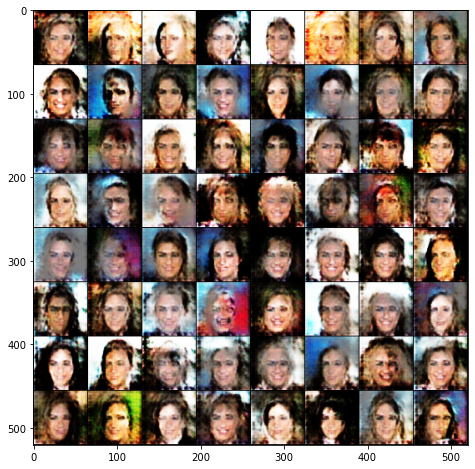

Saving generated-images-0000000.png
[0/10][1550/1586]	Loss_D: 0.6128	Loss_G: 2.5506	D(x): 0.6951	D(G(z)): 0.1404 / 0.1087
[1/10][0/1586]	Loss_D: 0.6669	Loss_G: 2.1717	D(x): 0.6456	D(G(z)): 0.0745 / 0.1708
[1/10][50/1586]	Loss_D: 1.0841	Loss_G: 7.3641	D(x): 0.9406	D(G(z)): 0.5834 / 0.0016
[1/10][100/1586]	Loss_D: 0.5437	Loss_G: 3.2726	D(x): 0.7835	D(G(z)): 0.2075 / 0.0573
[1/10][150/1586]	Loss_D: 0.4499	Loss_G: 4.3930	D(x): 0.8939	D(G(z)): 0.2428 / 0.0238
[1/10][200/1586]	Loss_D: 0.6006	Loss_G: 3.7566	D(x): 0.8092	D(G(z)): 0.2672 / 0.0401
[1/10][250/1586]	Loss_D: 0.5006	Loss_G: 2.7753	D(x): 0.7587	D(G(z)): 0.1545 / 0.0957
[1/10][300/1586]	Loss_D: 0.5765	Loss_G: 1.9051	D(x): 0.7315	D(G(z)): 0.1281 / 0.2176
[1/10][350/1586]	Loss_D: 0.4161	Loss_G: 2.8596	D(x): 0.7824	D(G(z)): 0.1180 / 0.0875
[1/10][400/1586]	Loss_D: 0.8415	Loss_G: 2.4201	D(x): 0.6174	D(G(z)): 0.1653 / 0.1302


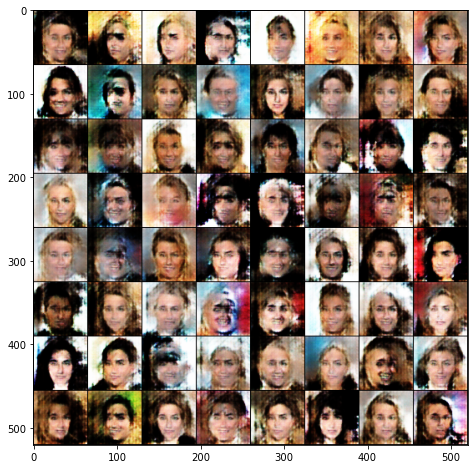

Saving generated-images-0000001.png
[1/10][450/1586]	Loss_D: 0.4353	Loss_G: 4.2078	D(x): 0.8986	D(G(z)): 0.2413 / 0.0248
[1/10][500/1586]	Loss_D: 0.4805	Loss_G: 3.4331	D(x): 0.8446	D(G(z)): 0.2232 / 0.0458
[1/10][550/1586]	Loss_D: 1.6560	Loss_G: 4.6860	D(x): 0.3390	D(G(z)): 0.0034 / 0.0249
[1/10][600/1586]	Loss_D: 0.4755	Loss_G: 2.4558	D(x): 0.7330	D(G(z)): 0.0925 / 0.1203
[1/10][650/1586]	Loss_D: 0.5788	Loss_G: 2.7488	D(x): 0.7538	D(G(z)): 0.1802 / 0.0940
[1/10][700/1586]	Loss_D: 0.3856	Loss_G: 3.4478	D(x): 0.8533	D(G(z)): 0.1646 / 0.0514
[1/10][750/1586]	Loss_D: 0.7392	Loss_G: 5.4402	D(x): 0.9050	D(G(z)): 0.4167 / 0.0075
[1/10][800/1586]	Loss_D: 0.3398	Loss_G: 4.3770	D(x): 0.8636	D(G(z)): 0.1409 / 0.0199
[1/10][850/1586]	Loss_D: 1.0692	Loss_G: 2.8029	D(x): 0.4410	D(G(z)): 0.0258 / 0.1066
[1/10][900/1586]	Loss_D: 0.4782	Loss_G: 3.1090	D(x): 0.8193	D(G(z)): 0.2022 / 0.0658


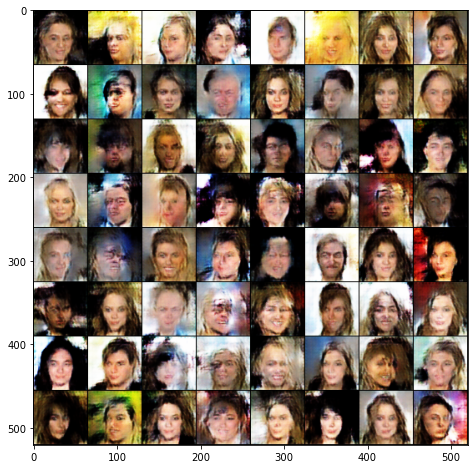

Saving generated-images-0000001.png
[1/10][950/1586]	Loss_D: 0.6530	Loss_G: 2.5714	D(x): 0.6042	D(G(z)): 0.0345 / 0.1166
[1/10][1000/1586]	Loss_D: 0.5677	Loss_G: 2.5643	D(x): 0.7420	D(G(z)): 0.1847 / 0.1150
[1/10][1050/1586]	Loss_D: 1.1305	Loss_G: 4.3430	D(x): 0.9004	D(G(z)): 0.5265 / 0.0388
[1/10][1100/1586]	Loss_D: 0.3193	Loss_G: 3.0289	D(x): 0.8252	D(G(z)): 0.0946 / 0.0689
[1/10][1150/1586]	Loss_D: 0.3871	Loss_G: 3.5804	D(x): 0.7849	D(G(z)): 0.0992 / 0.0437
[1/10][1200/1586]	Loss_D: 0.4464	Loss_G: 3.8062	D(x): 0.8985	D(G(z)): 0.2541 / 0.0335
[1/10][1250/1586]	Loss_D: 0.5415	Loss_G: 2.6496	D(x): 0.6921	D(G(z)): 0.0785 / 0.1015
[1/10][1300/1586]	Loss_D: 0.5400	Loss_G: 2.2594	D(x): 0.7474	D(G(z)): 0.1621 / 0.1361
[1/10][1350/1586]	Loss_D: 0.5344	Loss_G: 3.9521	D(x): 0.9178	D(G(z)): 0.3181 / 0.0328
[1/10][1400/1586]	Loss_D: 0.7356	Loss_G: 2.1725	D(x): 0.5772	D(G(z)): 0.0683 / 0.1676


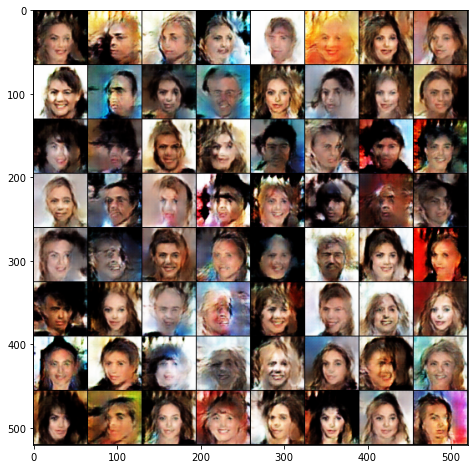

Saving generated-images-0000001.png
[1/10][1450/1586]	Loss_D: 1.1307	Loss_G: 5.3591	D(x): 0.9683	D(G(z)): 0.5969 / 0.0095
[1/10][1500/1586]	Loss_D: 0.4523	Loss_G: 2.4632	D(x): 0.7928	D(G(z)): 0.1668 / 0.1136
[1/10][1550/1586]	Loss_D: 0.8448	Loss_G: 1.7726	D(x): 0.5866	D(G(z)): 0.1245 / 0.2207
[2/10][0/1586]	Loss_D: 1.4618	Loss_G: 5.0648	D(x): 0.9783	D(G(z)): 0.6784 / 0.0120
[2/10][50/1586]	Loss_D: 0.4952	Loss_G: 1.5565	D(x): 0.7736	D(G(z)): 0.1668 / 0.2619
[2/10][100/1586]	Loss_D: 0.6007	Loss_G: 2.9191	D(x): 0.7149	D(G(z)): 0.1567 / 0.0907
[2/10][150/1586]	Loss_D: 0.4079	Loss_G: 2.7182	D(x): 0.7963	D(G(z)): 0.1293 / 0.0901
[2/10][200/1586]	Loss_D: 0.6560	Loss_G: 1.4032	D(x): 0.6673	D(G(z)): 0.1638 / 0.2842
[2/10][250/1586]	Loss_D: 0.8328	Loss_G: 2.3615	D(x): 0.7291	D(G(z)): 0.3373 / 0.1380
[2/10][300/1586]	Loss_D: 1.0421	Loss_G: 1.4873	D(x): 0.4408	D(G(z)): 0.0389 / 0.2943


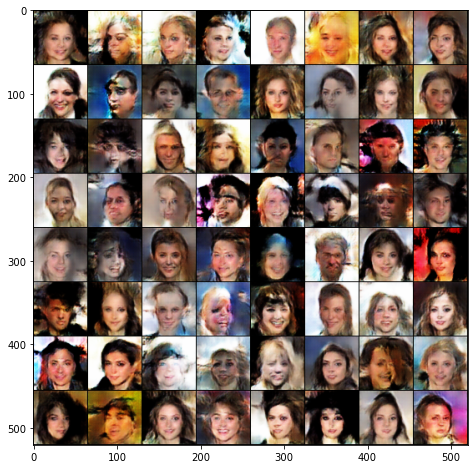

Saving generated-images-0000002.png
[2/10][350/1586]	Loss_D: 0.6897	Loss_G: 2.9885	D(x): 0.8448	D(G(z)): 0.3602 / 0.0762
[2/10][400/1586]	Loss_D: 0.6580	Loss_G: 2.1009	D(x): 0.6271	D(G(z)): 0.0984 / 0.1574
[2/10][450/1586]	Loss_D: 0.5099	Loss_G: 2.3828	D(x): 0.7735	D(G(z)): 0.1875 / 0.1195
[2/10][500/1586]	Loss_D: 0.9440	Loss_G: 1.1843	D(x): 0.5323	D(G(z)): 0.1547 / 0.3590
[2/10][550/1586]	Loss_D: 0.5035	Loss_G: 2.7976	D(x): 0.7987	D(G(z)): 0.2027 / 0.0855
[2/10][600/1586]	Loss_D: 0.5741	Loss_G: 1.5983	D(x): 0.6702	D(G(z)): 0.0949 / 0.2454
[2/10][650/1586]	Loss_D: 0.5001	Loss_G: 2.2775	D(x): 0.7825	D(G(z)): 0.1954 / 0.1263
[2/10][700/1586]	Loss_D: 0.6881	Loss_G: 1.6301	D(x): 0.6258	D(G(z)): 0.1179 / 0.2434
[2/10][750/1586]	Loss_D: 0.5507	Loss_G: 2.5674	D(x): 0.7969	D(G(z)): 0.2472 / 0.0920
[2/10][800/1586]	Loss_D: 0.5446	Loss_G: 3.3915	D(x): 0.8796	D(G(z)): 0.3086 / 0.0477


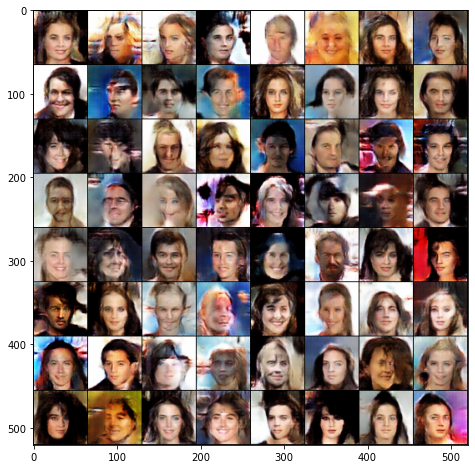

Saving generated-images-0000002.png
[2/10][850/1586]	Loss_D: 0.4917	Loss_G: 3.0776	D(x): 0.8419	D(G(z)): 0.2418 / 0.0597
[2/10][900/1586]	Loss_D: 0.6016	Loss_G: 1.7286	D(x): 0.6970	D(G(z)): 0.1457 / 0.2191
[2/10][950/1586]	Loss_D: 0.4538	Loss_G: 2.5835	D(x): 0.8550	D(G(z)): 0.2341 / 0.0926
[2/10][1000/1586]	Loss_D: 1.2932	Loss_G: 0.9378	D(x): 0.3496	D(G(z)): 0.0294 / 0.4666
[2/10][1050/1586]	Loss_D: 0.6966	Loss_G: 3.4700	D(x): 0.8632	D(G(z)): 0.3739 / 0.0460
[2/10][1100/1586]	Loss_D: 0.5744	Loss_G: 2.4336	D(x): 0.6429	D(G(z)): 0.0587 / 0.1239
[2/10][1150/1586]	Loss_D: 0.4514	Loss_G: 2.5127	D(x): 0.8010	D(G(z)): 0.1751 / 0.1017
[2/10][1200/1586]	Loss_D: 0.5717	Loss_G: 2.3530	D(x): 0.7674	D(G(z)): 0.2138 / 0.1239
[2/10][1250/1586]	Loss_D: 0.6597	Loss_G: 2.1921	D(x): 0.7073	D(G(z)): 0.2187 / 0.1443
[2/10][1300/1586]	Loss_D: 0.7485	Loss_G: 1.0415	D(x): 0.5953	D(G(z)): 0.1265 / 0.4091


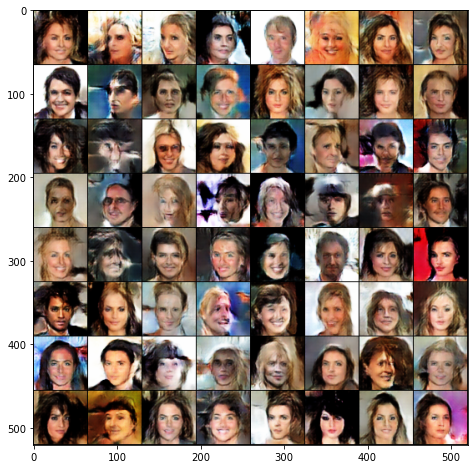

Saving generated-images-0000002.png
[2/10][1350/1586]	Loss_D: 0.5197	Loss_G: 2.1701	D(x): 0.7503	D(G(z)): 0.1686 / 0.1401
[2/10][1400/1586]	Loss_D: 0.7331	Loss_G: 2.3264	D(x): 0.7192	D(G(z)): 0.2682 / 0.1223
[2/10][1450/1586]	Loss_D: 0.7025	Loss_G: 3.8364	D(x): 0.9217	D(G(z)): 0.4252 / 0.0290
[2/10][1500/1586]	Loss_D: 0.8578	Loss_G: 1.2466	D(x): 0.5773	D(G(z)): 0.1740 / 0.3287
[2/10][1550/1586]	Loss_D: 0.9015	Loss_G: 1.8982	D(x): 0.6527	D(G(z)): 0.2955 / 0.2062
[3/10][0/1586]	Loss_D: 0.5613	Loss_G: 2.2645	D(x): 0.7466	D(G(z)): 0.1922 / 0.1361
[3/10][50/1586]	Loss_D: 0.5965	Loss_G: 1.7999	D(x): 0.7213	D(G(z)): 0.1946 / 0.2066
[3/10][100/1586]	Loss_D: 0.5187	Loss_G: 2.0962	D(x): 0.6949	D(G(z)): 0.1028 / 0.1493
[3/10][150/1586]	Loss_D: 0.7304	Loss_G: 1.9572	D(x): 0.5807	D(G(z)): 0.0805 / 0.1887
[3/10][200/1586]	Loss_D: 1.3514	Loss_G: 0.7299	D(x): 0.3299	D(G(z)): 0.0282 / 0.5388


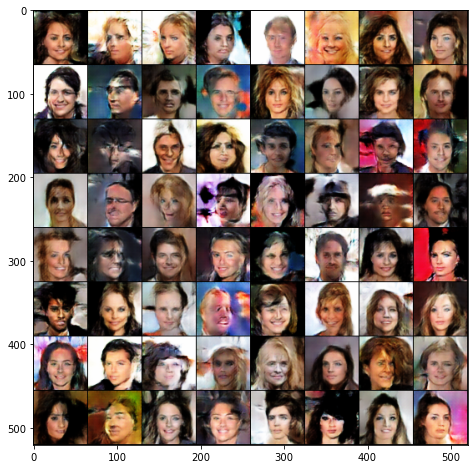

Saving generated-images-0000003.png
[3/10][250/1586]	Loss_D: 0.9013	Loss_G: 3.6356	D(x): 0.9282	D(G(z)): 0.5077 / 0.0428
[3/10][300/1586]	Loss_D: 0.6097	Loss_G: 2.1787	D(x): 0.6921	D(G(z)): 0.1662 / 0.1464
[3/10][350/1586]	Loss_D: 1.1998	Loss_G: 5.1081	D(x): 0.9397	D(G(z)): 0.6113 / 0.0103
[3/10][400/1586]	Loss_D: 0.7341	Loss_G: 2.2020	D(x): 0.6717	D(G(z)): 0.1993 / 0.1470
[3/10][450/1586]	Loss_D: 0.5244	Loss_G: 2.1071	D(x): 0.7010	D(G(z)): 0.1183 / 0.1560
[3/10][500/1586]	Loss_D: 0.4686	Loss_G: 2.3202	D(x): 0.7786	D(G(z)): 0.1661 / 0.1203
[3/10][550/1586]	Loss_D: 0.4947	Loss_G: 2.9260	D(x): 0.8178	D(G(z)): 0.2281 / 0.0685
[3/10][600/1586]	Loss_D: 1.3532	Loss_G: 0.6434	D(x): 0.3365	D(G(z)): 0.0200 / 0.5815
[3/10][650/1586]	Loss_D: 0.5056	Loss_G: 2.1446	D(x): 0.7060	D(G(z)): 0.1045 / 0.1496
[3/10][700/1586]	Loss_D: 1.1868	Loss_G: 1.0196	D(x): 0.4375	D(G(z)): 0.1752 / 0.4203


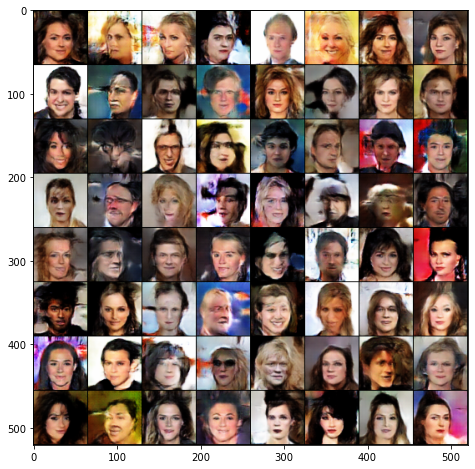

Saving generated-images-0000003.png
[3/10][750/1586]	Loss_D: 0.7155	Loss_G: 3.2653	D(x): 0.8928	D(G(z)): 0.4001 / 0.0512
[3/10][800/1586]	Loss_D: 1.5108	Loss_G: 0.4411	D(x): 0.2835	D(G(z)): 0.0402 / 0.6766
[3/10][850/1586]	Loss_D: 0.5389	Loss_G: 1.8172	D(x): 0.7022	D(G(z)): 0.1186 / 0.2039
[3/10][900/1586]	Loss_D: 0.6157	Loss_G: 2.4977	D(x): 0.8235	D(G(z)): 0.2961 / 0.1166
[3/10][950/1586]	Loss_D: 0.6106	Loss_G: 1.8834	D(x): 0.7308	D(G(z)): 0.1935 / 0.1889
[3/10][1000/1586]	Loss_D: 0.7331	Loss_G: 3.6064	D(x): 0.9264	D(G(z)): 0.4328 / 0.0369
[3/10][1050/1586]	Loss_D: 0.6171	Loss_G: 2.9378	D(x): 0.8098	D(G(z)): 0.3013 / 0.0675
[3/10][1100/1586]	Loss_D: 0.9233	Loss_G: 4.2763	D(x): 0.9128	D(G(z)): 0.5272 / 0.0182
[3/10][1150/1586]	Loss_D: 1.7441	Loss_G: 5.4518	D(x): 0.9742	D(G(z)): 0.7503 / 0.0085
[3/10][1200/1586]	Loss_D: 0.7685	Loss_G: 4.3709	D(x): 0.9379	D(G(z)): 0.4652 / 0.0192


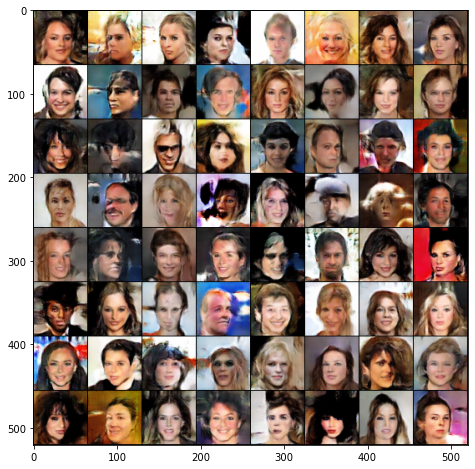

Saving generated-images-0000003.png
[3/10][1250/1586]	Loss_D: 0.7275	Loss_G: 1.2926	D(x): 0.5697	D(G(z)): 0.0748 / 0.3357
[3/10][1300/1586]	Loss_D: 0.8028	Loss_G: 4.4100	D(x): 0.9096	D(G(z)): 0.4403 / 0.0187
[3/10][1350/1586]	Loss_D: 0.6821	Loss_G: 1.9653	D(x): 0.6675	D(G(z)): 0.1915 / 0.1827
[3/10][1400/1586]	Loss_D: 1.0401	Loss_G: 0.7711	D(x): 0.4400	D(G(z)): 0.0668 / 0.5134
[3/10][1450/1586]	Loss_D: 0.7223	Loss_G: 1.6355	D(x): 0.6081	D(G(z)): 0.1319 / 0.2340
[3/10][1500/1586]	Loss_D: 0.9909	Loss_G: 1.5838	D(x): 0.4589	D(G(z)): 0.0649 / 0.2708
[3/10][1550/1586]	Loss_D: 0.6089	Loss_G: 2.9189	D(x): 0.7959	D(G(z)): 0.2751 / 0.0717
[4/10][0/1586]	Loss_D: 1.0537	Loss_G: 2.9015	D(x): 0.6731	D(G(z)): 0.3997 / 0.0754
[4/10][50/1586]	Loss_D: 0.8040	Loss_G: 1.7848	D(x): 0.5922	D(G(z)): 0.1507 / 0.2104
[4/10][100/1586]	Loss_D: 0.8330	Loss_G: 1.2287	D(x): 0.5174	D(G(z)): 0.0831 / 0.3370
[4/10][150/1586]	Loss_D: 0.6944	Loss_G: 1.4984	D(x): 0.5728	D(G(z)): 0.0633 / 0.2705


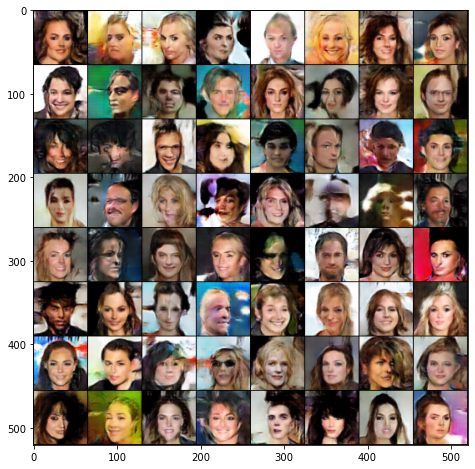

Saving generated-images-0000004.png
[4/10][200/1586]	Loss_D: 2.2586	Loss_G: 0.2971	D(x): 0.1498	D(G(z)): 0.0251 / 0.7665
[4/10][250/1586]	Loss_D: 0.4951	Loss_G: 2.1081	D(x): 0.8050	D(G(z)): 0.2095 / 0.1516
[4/10][300/1586]	Loss_D: 0.5589	Loss_G: 1.6595	D(x): 0.7369	D(G(z)): 0.1820 / 0.2280
[4/10][350/1586]	Loss_D: 0.8938	Loss_G: 1.1482	D(x): 0.5066	D(G(z)): 0.0932 / 0.3775
[4/10][400/1586]	Loss_D: 0.7910	Loss_G: 3.6671	D(x): 0.9129	D(G(z)): 0.4533 / 0.0373
[4/10][450/1586]	Loss_D: 1.0401	Loss_G: 2.3927	D(x): 0.7062	D(G(z)): 0.4374 / 0.1241
[4/10][500/1586]	Loss_D: 0.6177	Loss_G: 3.7973	D(x): 0.9047	D(G(z)): 0.3775 / 0.0286
[4/10][550/1586]	Loss_D: 0.6734	Loss_G: 3.0075	D(x): 0.7646	D(G(z)): 0.2848 / 0.0667
[4/10][600/1586]	Loss_D: 0.5885	Loss_G: 3.6045	D(x): 0.8962	D(G(z)): 0.3471 / 0.0369
[4/10][650/1586]	Loss_D: 0.8043	Loss_G: 1.0691	D(x): 0.5675	D(G(z)): 0.1328 / 0.3866


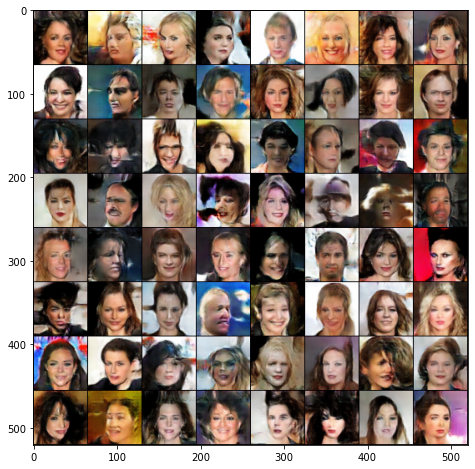

Saving generated-images-0000004.png
[4/10][700/1586]	Loss_D: 0.5099	Loss_G: 2.5802	D(x): 0.8203	D(G(z)): 0.2329 / 0.0952
[4/10][750/1586]	Loss_D: 0.4518	Loss_G: 2.5540	D(x): 0.7480	D(G(z)): 0.1103 / 0.1049
[4/10][800/1586]	Loss_D: 0.5692	Loss_G: 3.1991	D(x): 0.8753	D(G(z)): 0.3138 / 0.0540
[4/10][850/1586]	Loss_D: 1.0076	Loss_G: 2.7629	D(x): 0.7779	D(G(z)): 0.4411 / 0.0963
[4/10][900/1586]	Loss_D: 0.5009	Loss_G: 3.2016	D(x): 0.8652	D(G(z)): 0.2698 / 0.0542
[4/10][950/1586]	Loss_D: 0.7677	Loss_G: 1.3870	D(x): 0.5786	D(G(z)): 0.1309 / 0.3014
[4/10][1000/1586]	Loss_D: 0.5423	Loss_G: 1.9176	D(x): 0.6966	D(G(z)): 0.1166 / 0.1791
[4/10][1050/1586]	Loss_D: 0.6014	Loss_G: 1.6841	D(x): 0.6602	D(G(z)): 0.1198 / 0.2214
[4/10][1100/1586]	Loss_D: 0.7147	Loss_G: 2.4094	D(x): 0.7017	D(G(z)): 0.2480 / 0.1158
[4/10][1150/1586]	Loss_D: 1.4303	Loss_G: 1.2628	D(x): 0.3171	D(G(z)): 0.0368 / 0.3385


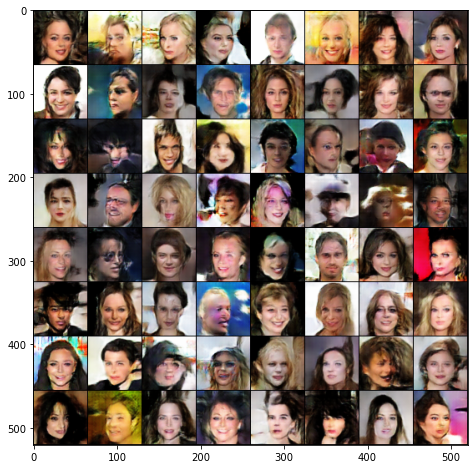

Saving generated-images-0000004.png
[4/10][1200/1586]	Loss_D: 0.6462	Loss_G: 3.6999	D(x): 0.9114	D(G(z)): 0.3824 / 0.0356
[4/10][1250/1586]	Loss_D: 0.8362	Loss_G: 2.1346	D(x): 0.7213	D(G(z)): 0.3468 / 0.1519
[4/10][1300/1586]	Loss_D: 0.4689	Loss_G: 3.4439	D(x): 0.8869	D(G(z)): 0.2716 / 0.0398
[4/10][1350/1586]	Loss_D: 3.5227	Loss_G: 6.7786	D(x): 0.9884	D(G(z)): 0.9401 / 0.0032
[4/10][1400/1586]	Loss_D: 0.5238	Loss_G: 2.3449	D(x): 0.7477	D(G(z)): 0.1709 / 0.1250
[4/10][1450/1586]	Loss_D: 0.6257	Loss_G: 1.6863	D(x): 0.6314	D(G(z)): 0.0956 / 0.2296
[4/10][1500/1586]	Loss_D: 1.0067	Loss_G: 1.2185	D(x): 0.5099	D(G(z)): 0.1911 / 0.3544
[4/10][1550/1586]	Loss_D: 0.5038	Loss_G: 3.1574	D(x): 0.8657	D(G(z)): 0.2767 / 0.0533
[5/10][0/1586]	Loss_D: 1.2712	Loss_G: 0.1799	D(x): 0.3849	D(G(z)): 0.1245 / 0.8516
[5/10][50/1586]	Loss_D: 0.5277	Loss_G: 2.1783	D(x): 0.6928	D(G(z)): 0.1069 / 0.1413


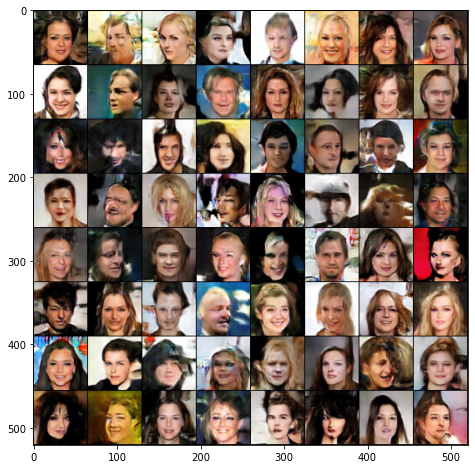

Saving generated-images-0000005.png
[5/10][100/1586]	Loss_D: 0.5639	Loss_G: 1.6191	D(x): 0.6555	D(G(z)): 0.0835 / 0.2511
[5/10][150/1586]	Loss_D: 1.0394	Loss_G: 5.5302	D(x): 0.9784	D(G(z)): 0.5823 / 0.0070
[5/10][200/1586]	Loss_D: 0.6250	Loss_G: 3.6218	D(x): 0.8408	D(G(z)): 0.3223 / 0.0393
[5/10][250/1586]	Loss_D: 0.4611	Loss_G: 3.3454	D(x): 0.8782	D(G(z)): 0.2570 / 0.0492
[5/10][300/1586]	Loss_D: 0.4780	Loss_G: 2.4455	D(x): 0.7510	D(G(z)): 0.1436 / 0.1116
[5/10][350/1586]	Loss_D: 0.4995	Loss_G: 2.6720	D(x): 0.8593	D(G(z)): 0.2682 / 0.0885
[5/10][400/1586]	Loss_D: 0.7330	Loss_G: 1.5532	D(x): 0.5852	D(G(z)): 0.0975 / 0.2458
[5/10][450/1586]	Loss_D: 0.4215	Loss_G: 3.4185	D(x): 0.8897	D(G(z)): 0.2434 / 0.0427
[5/10][500/1586]	Loss_D: 0.8911	Loss_G: 0.6877	D(x): 0.5004	D(G(z)): 0.0937 / 0.5453
[5/10][550/1586]	Loss_D: 0.7812	Loss_G: 1.2589	D(x): 0.5315	D(G(z)): 0.0649 / 0.3226


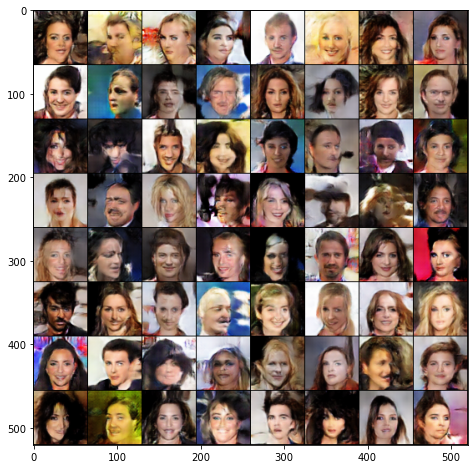

Saving generated-images-0000005.png
[5/10][600/1586]	Loss_D: 0.5134	Loss_G: 2.8276	D(x): 0.8750	D(G(z)): 0.2797 / 0.0772
[5/10][650/1586]	Loss_D: 0.5698	Loss_G: 2.9957	D(x): 0.8358	D(G(z)): 0.2873 / 0.0648
[5/10][700/1586]	Loss_D: 0.5630	Loss_G: 2.1469	D(x): 0.7688	D(G(z)): 0.2197 / 0.1384
[5/10][750/1586]	Loss_D: 0.3521	Loss_G: 3.3303	D(x): 0.8466	D(G(z)): 0.1460 / 0.0493
[5/10][800/1586]	Loss_D: 0.4798	Loss_G: 2.2266	D(x): 0.7954	D(G(z)): 0.1861 / 0.1419
[5/10][850/1586]	Loss_D: 0.8382	Loss_G: 1.1328	D(x): 0.5190	D(G(z)): 0.0710 / 0.3822
[5/10][900/1586]	Loss_D: 0.6203	Loss_G: 3.3020	D(x): 0.8869	D(G(z)): 0.3576 / 0.0483
[5/10][950/1586]	Loss_D: 1.1322	Loss_G: 1.5597	D(x): 0.3968	D(G(z)): 0.0567 / 0.2695
[5/10][1000/1586]	Loss_D: 0.4362	Loss_G: 2.4593	D(x): 0.7703	D(G(z)): 0.1317 / 0.1144
[5/10][1050/1586]	Loss_D: 0.4093	Loss_G: 3.6448	D(x): 0.9295	D(G(z)): 0.2545 / 0.0361


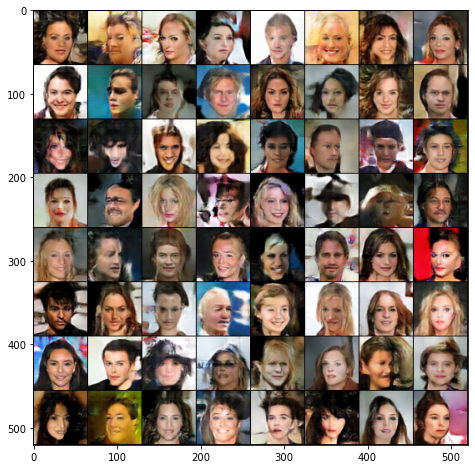

Saving generated-images-0000005.png
[5/10][1100/1586]	Loss_D: 0.8209	Loss_G: 4.1559	D(x): 0.9288	D(G(z)): 0.4714 / 0.0238
[5/10][1150/1586]	Loss_D: 0.4693	Loss_G: 1.8408	D(x): 0.7690	D(G(z)): 0.1573 / 0.1905
[5/10][1200/1586]	Loss_D: 0.4394	Loss_G: 2.1039	D(x): 0.7686	D(G(z)): 0.1322 / 0.1492
[5/10][1250/1586]	Loss_D: 0.6466	Loss_G: 1.9201	D(x): 0.7050	D(G(z)): 0.2038 / 0.1818
[5/10][1300/1586]	Loss_D: 0.4777	Loss_G: 3.7825	D(x): 0.9207	D(G(z)): 0.3053 / 0.0291
[5/10][1350/1586]	Loss_D: 0.6515	Loss_G: 3.9094	D(x): 0.8895	D(G(z)): 0.3700 / 0.0294
[5/10][1400/1586]	Loss_D: 0.8109	Loss_G: 3.6698	D(x): 0.8910	D(G(z)): 0.4506 / 0.0354
[5/10][1450/1586]	Loss_D: 0.4546	Loss_G: 2.4751	D(x): 0.8590	D(G(z)): 0.2365 / 0.1046
[5/10][1500/1586]	Loss_D: 0.5273	Loss_G: 3.1310	D(x): 0.8839	D(G(z)): 0.2902 / 0.0579
[5/10][1550/1586]	Loss_D: 0.5645	Loss_G: 3.0914	D(x): 0.8564	D(G(z)): 0.3068 / 0.0578


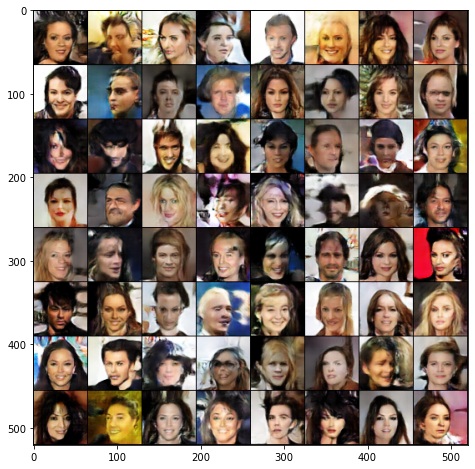

Saving generated-images-0000005.png
[6/10][0/1586]	Loss_D: 0.9055	Loss_G: 5.6006	D(x): 0.9685	D(G(z)): 0.5173 / 0.0059
[6/10][50/1586]	Loss_D: 1.0405	Loss_G: 5.5182	D(x): 0.9652	D(G(z)): 0.5892 / 0.0061
[6/10][100/1586]	Loss_D: 0.6147	Loss_G: 3.0374	D(x): 0.8170	D(G(z)): 0.3015 / 0.0637
[6/10][150/1586]	Loss_D: 0.9390	Loss_G: 4.3751	D(x): 0.9302	D(G(z)): 0.5188 / 0.0184
[6/10][200/1586]	Loss_D: 0.5906	Loss_G: 2.0495	D(x): 0.6326	D(G(z)): 0.0673 / 0.1628
[6/10][250/1586]	Loss_D: 0.4146	Loss_G: 2.2840	D(x): 0.7778	D(G(z)): 0.1267 / 0.1334
[6/10][300/1586]	Loss_D: 0.4978	Loss_G: 3.4938	D(x): 0.9160	D(G(z)): 0.3035 / 0.0417
[6/10][350/1586]	Loss_D: 0.4871	Loss_G: 2.2144	D(x): 0.6795	D(G(z)): 0.0597 / 0.1573
[6/10][400/1586]	Loss_D: 0.6843	Loss_G: 3.0402	D(x): 0.8324	D(G(z)): 0.3336 / 0.0706
[6/10][450/1586]	Loss_D: 0.4020	Loss_G: 2.1374	D(x): 0.7930	D(G(z)): 0.1317 / 0.1439


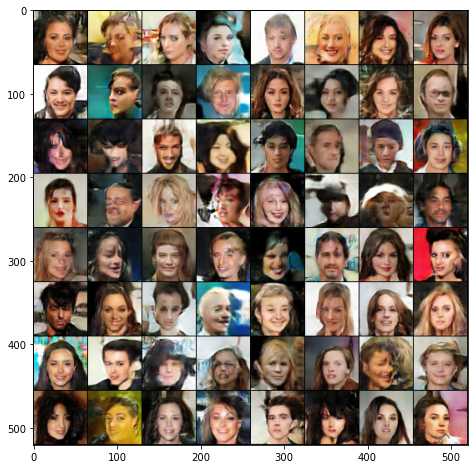

Saving generated-images-0000006.png
[6/10][500/1586]	Loss_D: 0.9847	Loss_G: 0.7823	D(x): 0.4440	D(G(z)): 0.0233 / 0.5055
[6/10][550/1586]	Loss_D: 0.6986	Loss_G: 2.0070	D(x): 0.6410	D(G(z)): 0.1487 / 0.1825
[6/10][600/1586]	Loss_D: 0.3931	Loss_G: 3.5863	D(x): 0.8911	D(G(z)): 0.2222 / 0.0364
[6/10][650/1586]	Loss_D: 0.6657	Loss_G: 1.8387	D(x): 0.6096	D(G(z)): 0.0895 / 0.2141
[6/10][700/1586]	Loss_D: 1.1630	Loss_G: 0.6447	D(x): 0.3796	D(G(z)): 0.0153 / 0.5710
[6/10][750/1586]	Loss_D: 0.3527	Loss_G: 3.6111	D(x): 0.9435	D(G(z)): 0.2388 / 0.0359
[6/10][800/1586]	Loss_D: 1.2992	Loss_G: 1.8747	D(x): 0.4970	D(G(z)): 0.2606 / 0.2229
[6/10][850/1586]	Loss_D: 0.4194	Loss_G: 2.1745	D(x): 0.7692	D(G(z)): 0.1127 / 0.1514
[6/10][900/1586]	Loss_D: 0.4540	Loss_G: 2.8633	D(x): 0.8703	D(G(z)): 0.2343 / 0.0774
[6/10][950/1586]	Loss_D: 0.3775	Loss_G: 3.7955	D(x): 0.9256	D(G(z)): 0.2391 / 0.0316


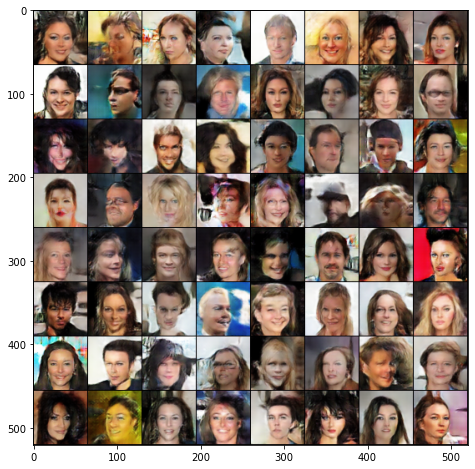

Saving generated-images-0000006.png
[6/10][1000/1586]	Loss_D: 0.4963	Loss_G: 1.9538	D(x): 0.6886	D(G(z)): 0.0783 / 0.1892
[6/10][1050/1586]	Loss_D: 0.8399	Loss_G: 5.1445	D(x): 0.9244	D(G(z)): 0.4720 / 0.0097
[6/10][1100/1586]	Loss_D: 0.4549	Loss_G: 3.4116	D(x): 0.9578	D(G(z)): 0.3075 / 0.0483
[6/10][1150/1586]	Loss_D: 0.5101	Loss_G: 1.4696	D(x): 0.7258	D(G(z)): 0.1335 / 0.2809
[6/10][1200/1586]	Loss_D: 0.5396	Loss_G: 4.3106	D(x): 0.9184	D(G(z)): 0.3332 / 0.0195
[6/10][1250/1586]	Loss_D: 0.4540	Loss_G: 3.7257	D(x): 0.9071	D(G(z)): 0.2748 / 0.0303
[6/10][1300/1586]	Loss_D: 0.6748	Loss_G: 1.5329	D(x): 0.5991	D(G(z)): 0.0760 / 0.2654
[6/10][1350/1586]	Loss_D: 0.6362	Loss_G: 1.4744	D(x): 0.6265	D(G(z)): 0.0779 / 0.2883
[6/10][1400/1586]	Loss_D: 0.8054	Loss_G: 3.7813	D(x): 0.8901	D(G(z)): 0.4322 / 0.0353
[6/10][1450/1586]	Loss_D: 0.4206	Loss_G: 2.1315	D(x): 0.7788	D(G(z)): 0.1277 / 0.1449


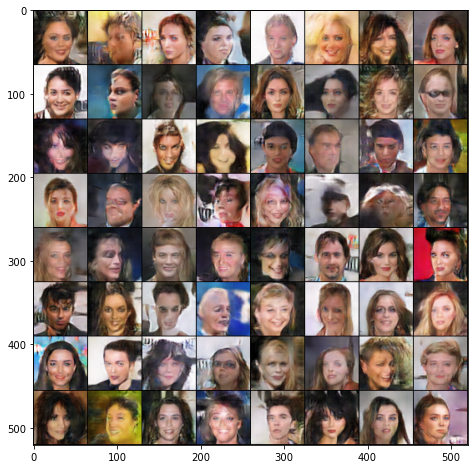

Saving generated-images-0000006.png
[6/10][1500/1586]	Loss_D: 1.4118	Loss_G: 4.9961	D(x): 0.9575	D(G(z)): 0.6749 / 0.0117
[6/10][1550/1586]	Loss_D: 0.4597	Loss_G: 2.3351	D(x): 0.7422	D(G(z)): 0.1158 / 0.1266
[7/10][0/1586]	Loss_D: 0.5636	Loss_G: 2.8829	D(x): 0.7890	D(G(z)): 0.2357 / 0.0773
[7/10][50/1586]	Loss_D: 0.3993	Loss_G: 2.2880	D(x): 0.7664	D(G(z)): 0.0907 / 0.1314
[7/10][100/1586]	Loss_D: 0.3340	Loss_G: 3.3679	D(x): 0.8965	D(G(z)): 0.1771 / 0.0514
[7/10][150/1586]	Loss_D: 0.5359	Loss_G: 1.4165	D(x): 0.6844	D(G(z)): 0.0957 / 0.2881
[7/10][200/1586]	Loss_D: 0.4586	Loss_G: 2.9982	D(x): 0.8769	D(G(z)): 0.2509 / 0.0681
[7/10][250/1586]	Loss_D: 2.2082	Loss_G: 0.2795	D(x): 0.1684	D(G(z)): 0.0186 / 0.7873
[7/10][300/1586]	Loss_D: 0.3652	Loss_G: 2.7828	D(x): 0.8650	D(G(z)): 0.1741 / 0.0801
[7/10][350/1586]	Loss_D: 0.4404	Loss_G: 2.5973	D(x): 0.8454	D(G(z)): 0.2083 / 0.0992


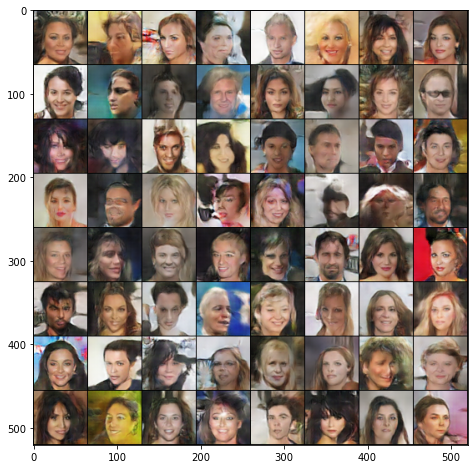

Saving generated-images-0000007.png
[7/10][400/1586]	Loss_D: 0.4624	Loss_G: 2.2141	D(x): 0.7705	D(G(z)): 0.1518 / 0.1397
[7/10][450/1586]	Loss_D: 0.7601	Loss_G: 1.6111	D(x): 0.5871	D(G(z)): 0.1005 / 0.2621
[7/10][500/1586]	Loss_D: 0.3048	Loss_G: 3.4968	D(x): 0.8671	D(G(z)): 0.1298 / 0.0405
[7/10][550/1586]	Loss_D: 0.5967	Loss_G: 4.0527	D(x): 0.9453	D(G(z)): 0.3783 / 0.0255
[7/10][600/1586]	Loss_D: 0.8537	Loss_G: 4.5453	D(x): 0.8869	D(G(z)): 0.4571 / 0.0166
[7/10][650/1586]	Loss_D: 0.8385	Loss_G: 1.9270	D(x): 0.5453	D(G(z)): 0.1364 / 0.2004
[7/10][700/1586]	Loss_D: 0.5531	Loss_G: 1.6573	D(x): 0.7267	D(G(z)): 0.1560 / 0.2426
[7/10][750/1586]	Loss_D: 0.4651	Loss_G: 3.0123	D(x): 0.8418	D(G(z)): 0.2271 / 0.0629
[7/10][800/1586]	Loss_D: 2.7188	Loss_G: 6.3861	D(x): 0.9901	D(G(z)): 0.8906 / 0.0051
[7/10][850/1586]	Loss_D: 0.4010	Loss_G: 2.2693	D(x): 0.7650	D(G(z)): 0.0873 / 0.1400


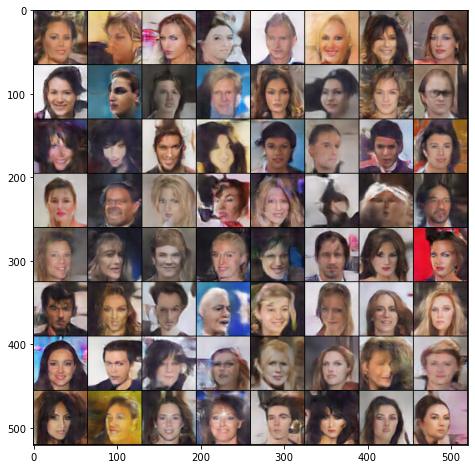

Saving generated-images-0000007.png
[7/10][900/1586]	Loss_D: 0.4849	Loss_G: 4.2099	D(x): 0.9054	D(G(z)): 0.2903 / 0.0196
[7/10][950/1586]	Loss_D: 0.7604	Loss_G: 1.7812	D(x): 0.5456	D(G(z)): 0.0488 / 0.2211
[7/10][1000/1586]	Loss_D: 0.4894	Loss_G: 3.1153	D(x): 0.8951	D(G(z)): 0.2837 / 0.0656
[7/10][1050/1586]	Loss_D: 0.3786	Loss_G: 2.5266	D(x): 0.7953	D(G(z)): 0.1140 / 0.1046
[7/10][1100/1586]	Loss_D: 0.3581	Loss_G: 2.5661	D(x): 0.8666	D(G(z)): 0.1712 / 0.1013
[7/10][1150/1586]	Loss_D: 0.3249	Loss_G: 2.9292	D(x): 0.8095	D(G(z)): 0.0860 / 0.0784
[7/10][1200/1586]	Loss_D: 0.5247	Loss_G: 2.1220	D(x): 0.7470	D(G(z)): 0.1621 / 0.1583
[7/10][1250/1586]	Loss_D: 0.3120	Loss_G: 2.7996	D(x): 0.8215	D(G(z)): 0.0899 / 0.0867
[7/10][1300/1586]	Loss_D: 0.6158	Loss_G: 4.0989	D(x): 0.9389	D(G(z)): 0.3734 / 0.0241
[7/10][1350/1586]	Loss_D: 0.6488	Loss_G: 4.6840	D(x): 0.9171	D(G(z)): 0.3843 / 0.0157


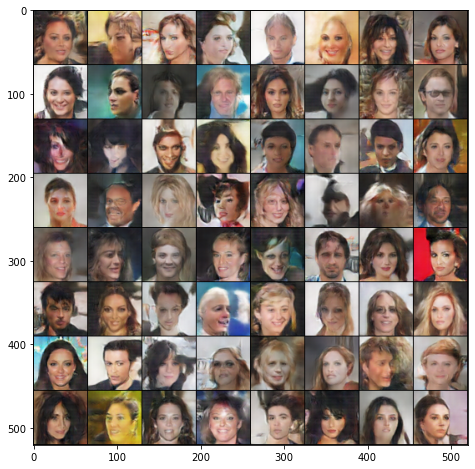

Saving generated-images-0000007.png
[7/10][1400/1586]	Loss_D: 0.9581	Loss_G: 2.5299	D(x): 0.5135	D(G(z)): 0.1206 / 0.1390
[7/10][1450/1586]	Loss_D: 0.3498	Loss_G: 2.7454	D(x): 0.7975	D(G(z)): 0.0924 / 0.0880
[7/10][1500/1586]	Loss_D: 0.6954	Loss_G: 3.7624	D(x): 0.8154	D(G(z)): 0.3243 / 0.0352
[7/10][1550/1586]	Loss_D: 0.5435	Loss_G: 1.7715	D(x): 0.6897	D(G(z)): 0.1016 / 0.2190
[8/10][0/1586]	Loss_D: 0.4173	Loss_G: 2.7924	D(x): 0.7901	D(G(z)): 0.1307 / 0.0902
[8/10][50/1586]	Loss_D: 1.3917	Loss_G: 0.6789	D(x): 0.3199	D(G(z)): 0.0150 / 0.5686
[8/10][100/1586]	Loss_D: 0.4149	Loss_G: 2.4773	D(x): 0.8203	D(G(z)): 0.1677 / 0.1122
[8/10][150/1586]	Loss_D: 0.5501	Loss_G: 2.8057	D(x): 0.6432	D(G(z)): 0.0446 / 0.0926
[8/10][200/1586]	Loss_D: 0.4043	Loss_G: 2.6663	D(x): 0.8191	D(G(z)): 0.1529 / 0.0942
[8/10][250/1586]	Loss_D: 0.6546	Loss_G: 2.0675	D(x): 0.6046	D(G(z)): 0.0646 / 0.1702
[8/10][300/1586]	Loss_D: 1.2021	Loss_G: 0.8801	D(x): 0.3831	D(G(z)): 0.0212 / 0.4916


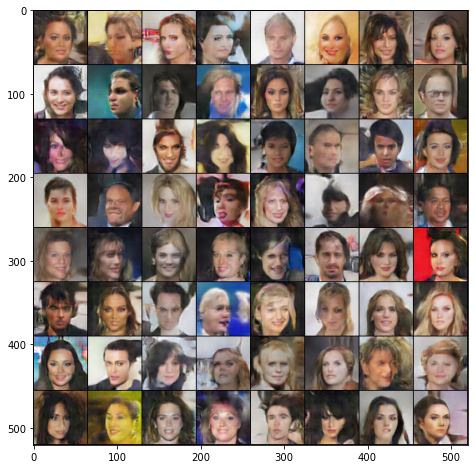

Saving generated-images-0000008.png
[8/10][350/1586]	Loss_D: 0.2863	Loss_G: 3.0482	D(x): 0.8835	D(G(z)): 0.1326 / 0.0652
[8/10][400/1586]	Loss_D: 0.4832	Loss_G: 2.1716	D(x): 0.8332	D(G(z)): 0.2274 / 0.1530
[8/10][450/1586]	Loss_D: 0.5336	Loss_G: 3.2256	D(x): 0.8425	D(G(z)): 0.2627 / 0.0548
[8/10][500/1586]	Loss_D: 0.3583	Loss_G: 3.0996	D(x): 0.8923	D(G(z)): 0.1907 / 0.0611
[8/10][550/1586]	Loss_D: 0.3618	Loss_G: 2.9362	D(x): 0.7945	D(G(z)): 0.0970 / 0.0829
[8/10][600/1586]	Loss_D: 0.4561	Loss_G: 4.1794	D(x): 0.9310	D(G(z)): 0.2879 / 0.0216
[8/10][650/1586]	Loss_D: 1.3957	Loss_G: 6.4338	D(x): 0.9800	D(G(z)): 0.6706 / 0.0029
[8/10][700/1586]	Loss_D: 0.4027	Loss_G: 2.9284	D(x): 0.8639	D(G(z)): 0.2028 / 0.0732
[8/10][750/1586]	Loss_D: 0.2958	Loss_G: 2.5143	D(x): 0.8414	D(G(z)): 0.0974 / 0.1099
[8/10][800/1586]	Loss_D: 0.3364	Loss_G: 2.5259	D(x): 0.8089	D(G(z)): 0.0989 / 0.1073


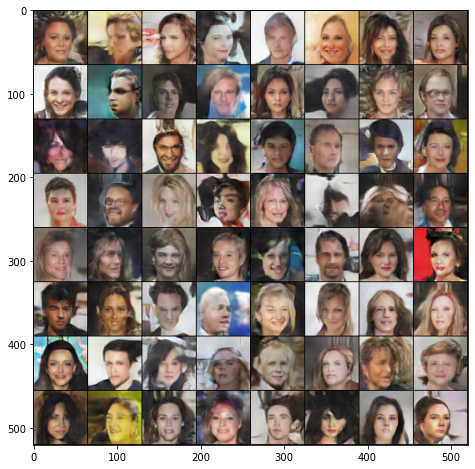

Saving generated-images-0000008.png
[8/10][850/1586]	Loss_D: 0.4168	Loss_G: 3.0704	D(x): 0.9016	D(G(z)): 0.2337 / 0.0671
[8/10][900/1586]	Loss_D: 0.5946	Loss_G: 4.0084	D(x): 0.9244	D(G(z)): 0.3572 / 0.0271
[8/10][950/1586]	Loss_D: 1.8931	Loss_G: 5.4371	D(x): 0.9553	D(G(z)): 0.7723 / 0.0111
[8/10][1000/1586]	Loss_D: 0.8748	Loss_G: 1.1358	D(x): 0.4912	D(G(z)): 0.0358 / 0.3827
[8/10][1050/1586]	Loss_D: 0.6944	Loss_G: 5.7484	D(x): 0.9744	D(G(z)): 0.4371 / 0.0051
[8/10][1100/1586]	Loss_D: 0.3807	Loss_G: 3.1394	D(x): 0.8685	D(G(z)): 0.1796 / 0.0622
[8/10][1150/1586]	Loss_D: 2.0655	Loss_G: 4.5860	D(x): 0.9529	D(G(z)): 0.7917 / 0.0255
[8/10][1200/1586]	Loss_D: 0.4544	Loss_G: 2.2978	D(x): 0.7562	D(G(z)): 0.1138 / 0.1479
[8/10][1250/1586]	Loss_D: 0.2166	Loss_G: 3.2174	D(x): 0.8870	D(G(z)): 0.0812 / 0.0534
[8/10][1300/1586]	Loss_D: 0.3125	Loss_G: 3.8466	D(x): 0.8267	D(G(z)): 0.0913 / 0.0373


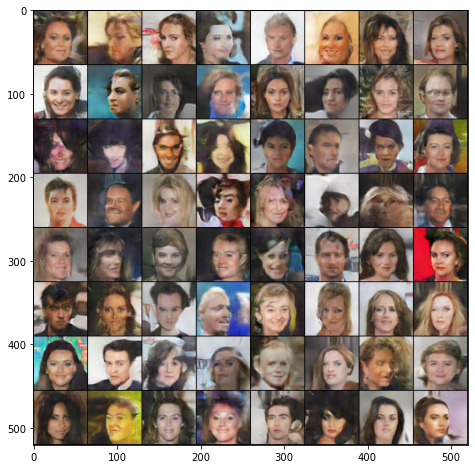

Saving generated-images-0000008.png
[8/10][1350/1586]	Loss_D: 0.4821	Loss_G: 3.1826	D(x): 0.7818	D(G(z)): 0.1629 / 0.0656
[8/10][1400/1586]	Loss_D: 0.3299	Loss_G: 2.9923	D(x): 0.8531	D(G(z)): 0.1394 / 0.0679
[8/10][1450/1586]	Loss_D: 0.5535	Loss_G: 2.3787	D(x): 0.6814	D(G(z)): 0.0837 / 0.1429
[8/10][1500/1586]	Loss_D: 0.2085	Loss_G: 3.5792	D(x): 0.8961	D(G(z)): 0.0832 / 0.0407
[8/10][1550/1586]	Loss_D: 0.2877	Loss_G: 3.4211	D(x): 0.8842	D(G(z)): 0.1363 / 0.0429
[9/10][0/1586]	Loss_D: 0.9696	Loss_G: 6.3150	D(x): 0.9580	D(G(z)): 0.5176 / 0.0035
[9/10][50/1586]	Loss_D: 0.4686	Loss_G: 2.5721	D(x): 0.7706	D(G(z)): 0.1480 / 0.1062
[9/10][100/1586]	Loss_D: 0.4886	Loss_G: 4.5223	D(x): 0.9465	D(G(z)): 0.3118 / 0.0172
[9/10][150/1586]	Loss_D: 0.2761	Loss_G: 3.3287	D(x): 0.9052	D(G(z)): 0.1409 / 0.0514
[9/10][200/1586]	Loss_D: 0.2860	Loss_G: 2.9837	D(x): 0.8888	D(G(z)): 0.1374 / 0.0719


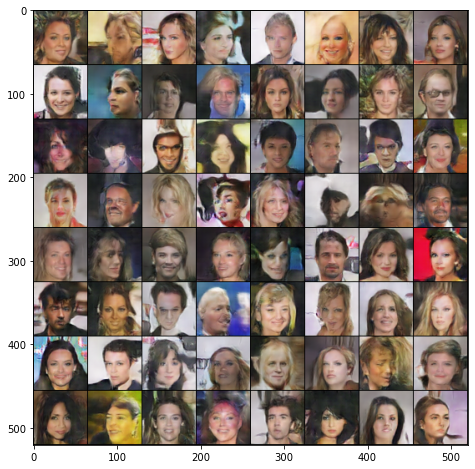

Saving generated-images-0000009.png
[9/10][250/1586]	Loss_D: 1.4129	Loss_G: 6.0375	D(x): 0.9815	D(G(z)): 0.6801 / 0.0053
[9/10][300/1586]	Loss_D: 0.6100	Loss_G: 4.2061	D(x): 0.9234	D(G(z)): 0.3494 / 0.0236
[9/10][350/1586]	Loss_D: 0.3828	Loss_G: 2.2738	D(x): 0.7659	D(G(z)): 0.0820 / 0.1398
[9/10][400/1586]	Loss_D: 0.5155	Loss_G: 4.3034	D(x): 0.9359	D(G(z)): 0.3158 / 0.0206
[9/10][450/1586]	Loss_D: 0.3259	Loss_G: 2.7727	D(x): 0.8081	D(G(z)): 0.0864 / 0.0928
[9/10][500/1586]	Loss_D: 0.1980	Loss_G: 3.1627	D(x): 0.9242	D(G(z)): 0.1038 / 0.0593
[9/10][550/1586]	Loss_D: 0.2992	Loss_G: 2.7264	D(x): 0.8338	D(G(z)): 0.0856 / 0.0934
[9/10][600/1586]	Loss_D: 0.2434	Loss_G: 3.2489	D(x): 0.9049	D(G(z)): 0.1151 / 0.0561
[9/10][650/1586]	Loss_D: 0.3502	Loss_G: 2.7906	D(x): 0.8287	D(G(z)): 0.1192 / 0.0924
[9/10][700/1586]	Loss_D: 0.5703	Loss_G: 1.9765	D(x): 0.7031	D(G(z)): 0.1372 / 0.1931


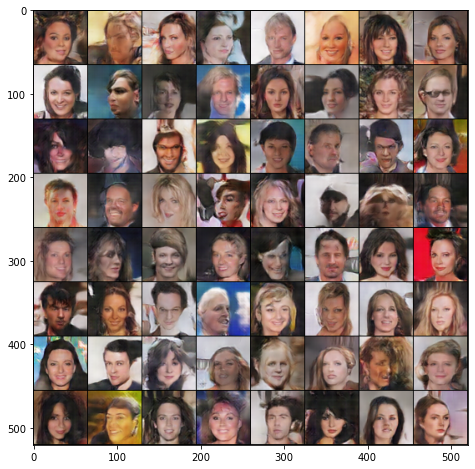

Saving generated-images-0000009.png
[9/10][750/1586]	Loss_D: 1.5807	Loss_G: 0.7659	D(x): 0.3029	D(G(z)): 0.0637 / 0.5393
[9/10][800/1586]	Loss_D: 0.3261	Loss_G: 2.6519	D(x): 0.8144	D(G(z)): 0.0943 / 0.0960
[9/10][850/1586]	Loss_D: 0.4620	Loss_G: 2.2013	D(x): 0.6938	D(G(z)): 0.0443 / 0.1587
[9/10][900/1586]	Loss_D: 0.1776	Loss_G: 3.3750	D(x): 0.9133	D(G(z)): 0.0767 / 0.0484
[9/10][950/1586]	Loss_D: 0.2598	Loss_G: 3.2848	D(x): 0.8689	D(G(z)): 0.0956 / 0.0533
[9/10][1000/1586]	Loss_D: 0.8412	Loss_G: 5.3114	D(x): 0.9844	D(G(z)): 0.4645 / 0.0103
[9/10][1050/1586]	Loss_D: 0.9843	Loss_G: 4.8048	D(x): 0.9489	D(G(z)): 0.5275 / 0.0146
[9/10][1100/1586]	Loss_D: 0.5229	Loss_G: 3.6604	D(x): 0.8692	D(G(z)): 0.2725 / 0.0381
[9/10][1150/1586]	Loss_D: 0.4593	Loss_G: 3.4358	D(x): 0.8689	D(G(z)): 0.2354 / 0.0471
[9/10][1200/1586]	Loss_D: 0.2240	Loss_G: 3.4509	D(x): 0.9390	D(G(z)): 0.1355 / 0.0431


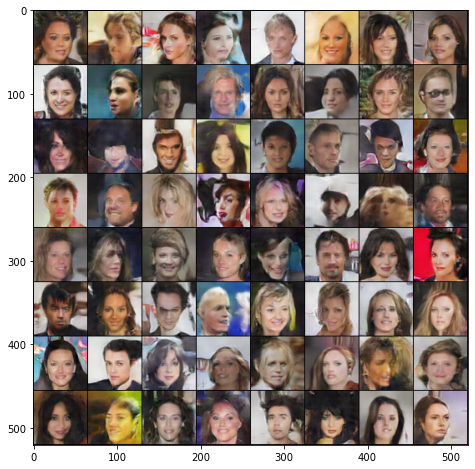

Saving generated-images-0000009.png
[9/10][1250/1586]	Loss_D: 1.2130	Loss_G: 0.8335	D(x): 0.3673	D(G(z)): 0.0070 / 0.5056
[9/10][1300/1586]	Loss_D: 0.3036	Loss_G: 2.9801	D(x): 0.8983	D(G(z)): 0.1583 / 0.0718
[9/10][1350/1586]	Loss_D: 0.6890	Loss_G: 3.5244	D(x): 0.8373	D(G(z)): 0.3319 / 0.0473
[9/10][1400/1586]	Loss_D: 0.1634	Loss_G: 4.9375	D(x): 0.8914	D(G(z)): 0.0403 / 0.0129
[9/10][1450/1586]	Loss_D: 0.3857	Loss_G: 2.6273	D(x): 0.7405	D(G(z)): 0.0454 / 0.1087
[9/10][1500/1586]	Loss_D: 0.5044	Loss_G: 2.5909	D(x): 0.7294	D(G(z)): 0.1264 / 0.1033
[9/10][1550/1586]	Loss_D: 0.2597	Loss_G: 3.2015	D(x): 0.9213	D(G(z)): 0.1443 / 0.0573


In [13]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        visualize_step = 2
        if iters % 500 == 0:
            fig = plt.figure(figsize = (8, 8))   
            ax1 = plt.subplot(111)
            image = make_grid(netG(fixed_noise.detach()).cpu().detach(), padding=1, normalize=True)
            ax1.imshow(image.numpy().transpose((1, 2, 0)))
            plt.show()
            fake_fname = 'generated-images-{0:0=7d}.png'.format(epoch)
            save_image(image, os.path.join(sample_dir, fake_fname), nrow=8)
            print('Saving', fake_fname)
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

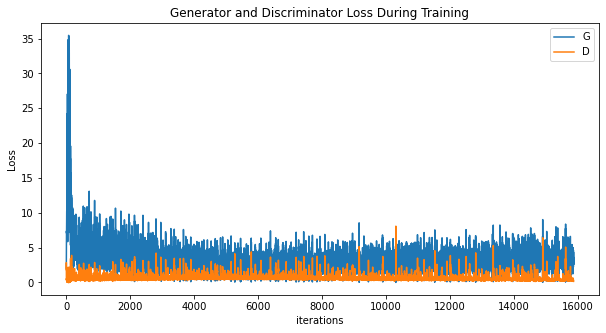

In [14]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

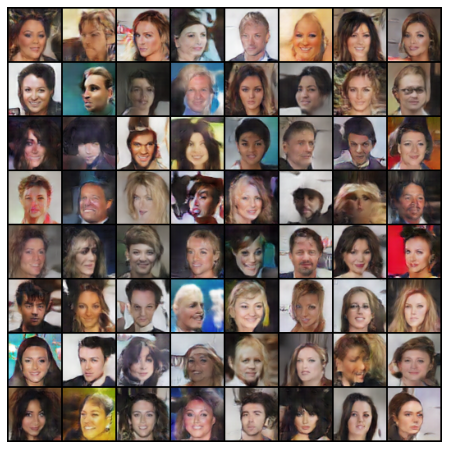

In [15]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

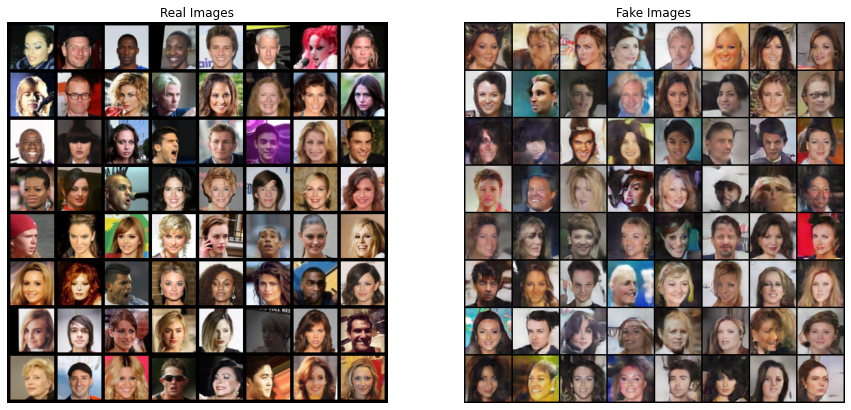

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()